In [1]:
from PIL import Image, ImageSequence
import numpy as np
import glob
import yaml
from tqdm import tqdm
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, RobustScaler

In [2]:
def load_image(img_path, sample):
    # Open image and hunt down separate channels
    with Image.open(img_path) as im:
        channels = []
        for ch in ImageSequence.Iterator(im):
            ch = np.array(ch)
            channels.append(ch)
        
    channels = np.stack(channels, axis=2)
    dim = channels.shape
    channels_pca_rbg = PCA(n_components=3).fit_transform(channels.reshape(-1, dim[-1]))
    scaled_image = MinMaxScaler(feature_range=(0, 255)).fit_transform(channels_pca_rbg)
    scaled_image = scaled_image.reshape(*dim[:2], 3)
    
    #scaled_image = ((channels_pca_rbg - channels_pca_rbg.min(axis=(0,1), keepdims=True)) / (channels_pca_rbg.max(axis=(0,1), keepdims=True) - channels_pca_rbg.min(axis=(0,1), keepdims=True))) * 255
    scaled_image = scaled_image.astype(np.uint8)
    scaled_image = Image.fromarray(scaled_image)
    plt.imshow(scaled_image)
    plt.show()
    scaled_image.save(f"data/{sample}_pca_rgb.jpg")

In [3]:
with open("info.yaml", "r") as stream:
    INFO = yaml.safe_load(stream)
SAMPLES = INFO["SAMPLE"]
len(SAMPLES)

100

  0%|          | 0/100 [00:00<?, ?it/s]

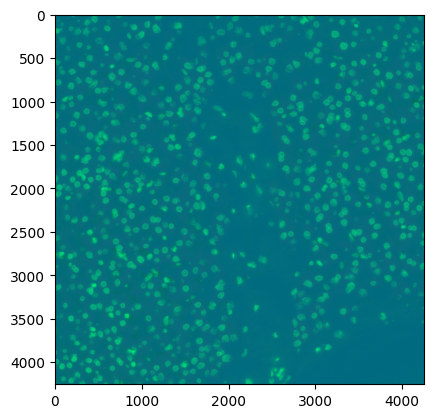

  1%|          | 1/100 [00:27<45:06, 27.34s/it]

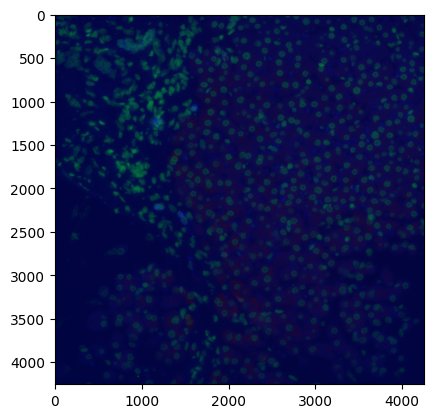

  2%|▏         | 2/100 [00:53<43:52, 26.87s/it]

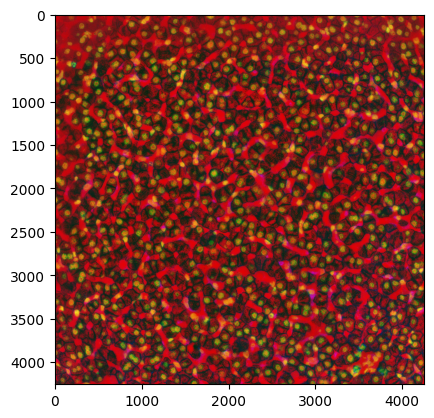

  3%|▎         | 3/100 [01:19<42:46, 26.46s/it]

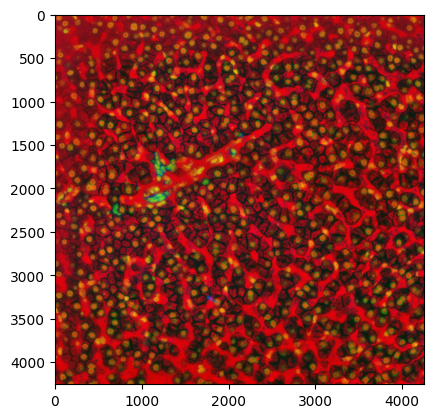

  4%|▍         | 4/100 [01:46<42:44, 26.71s/it]

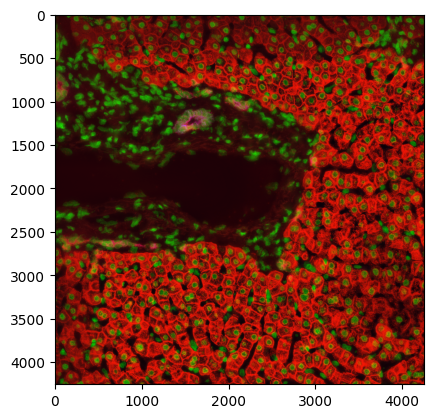

  5%|▌         | 5/100 [02:13<42:14, 26.68s/it]

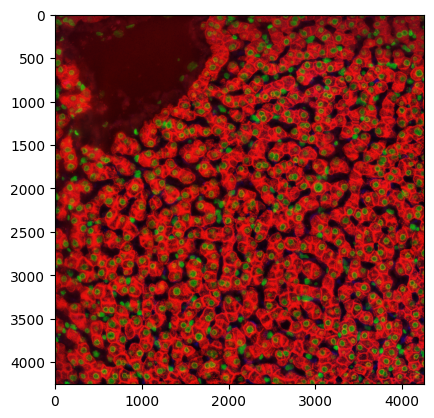

  6%|▌         | 6/100 [02:40<42:00, 26.81s/it]

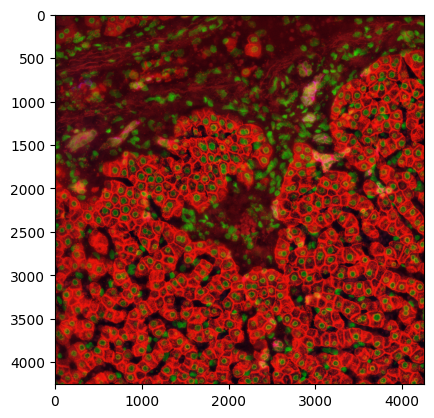

  7%|▋         | 7/100 [03:06<41:17, 26.64s/it]

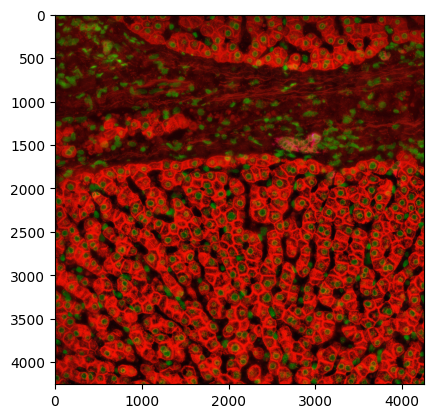

  8%|▊         | 8/100 [03:32<40:25, 26.36s/it]

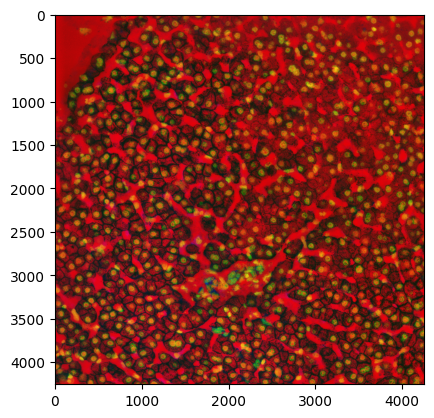

  9%|▉         | 9/100 [03:59<40:04, 26.42s/it]

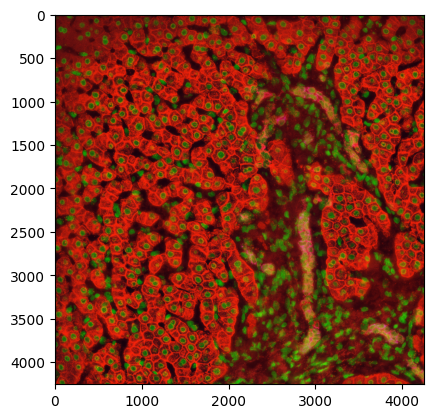

 10%|█         | 10/100 [04:25<39:37, 26.41s/it]

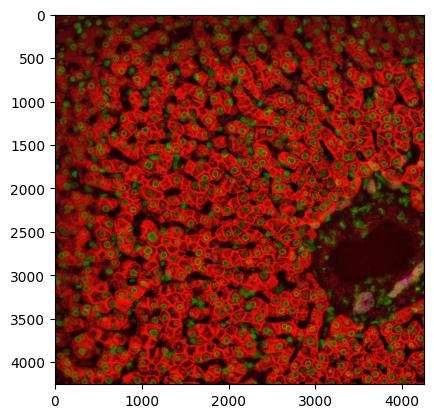

 11%|█         | 11/100 [04:53<39:37, 26.72s/it]

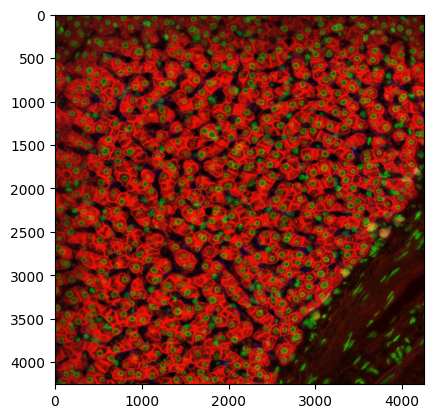

 12%|█▏        | 12/100 [05:19<39:12, 26.73s/it]

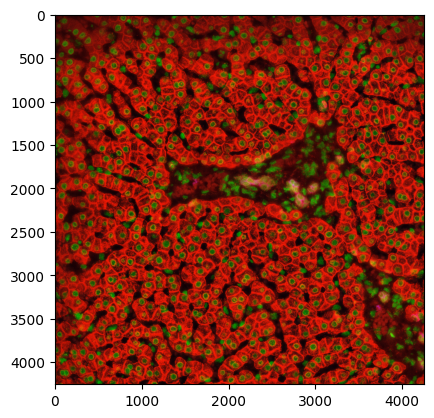

 13%|█▎        | 13/100 [05:46<38:51, 26.80s/it]

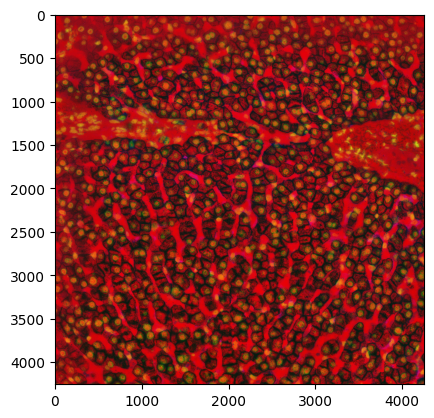

 14%|█▍        | 14/100 [06:13<38:18, 26.72s/it]

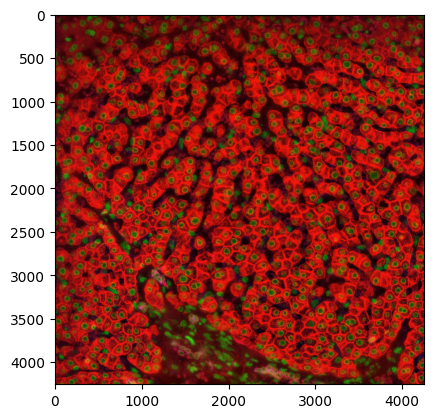

 15%|█▌        | 15/100 [06:39<37:44, 26.64s/it]

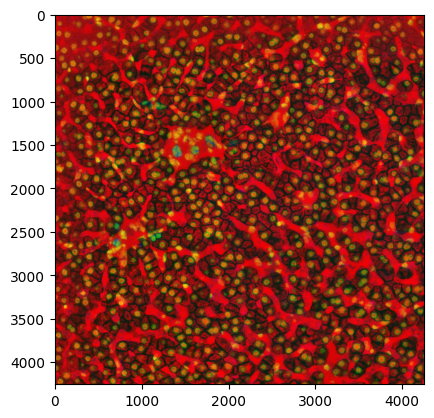

 16%|█▌        | 16/100 [07:05<37:00, 26.44s/it]

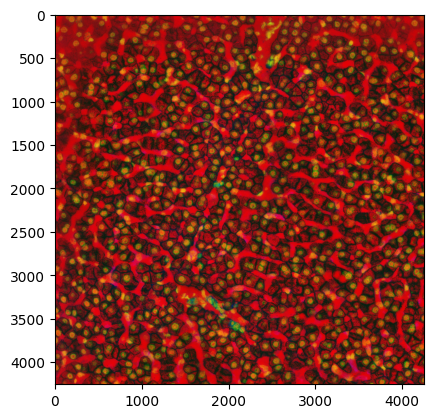

 17%|█▋        | 17/100 [07:32<36:37, 26.48s/it]

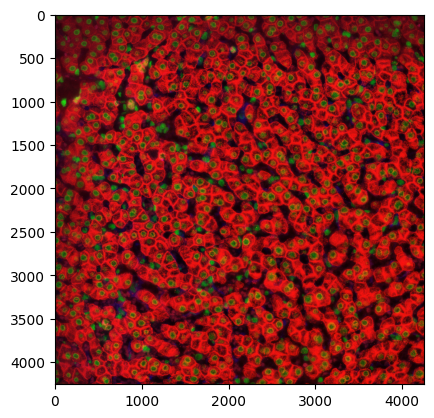

 18%|█▊        | 18/100 [07:59<36:26, 26.66s/it]

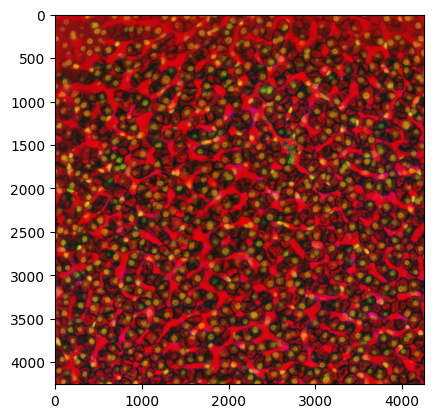

 19%|█▉        | 19/100 [08:26<36:07, 26.75s/it]

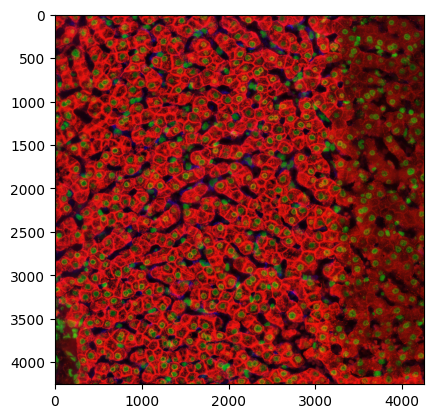

 20%|██        | 20/100 [08:52<35:21, 26.52s/it]

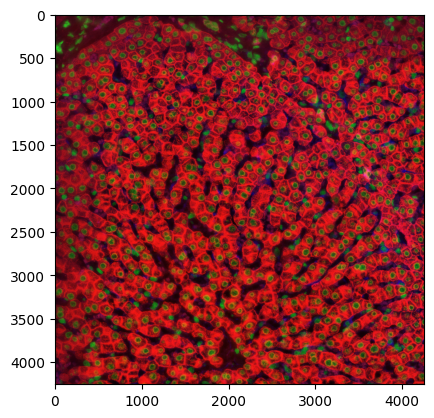

 21%|██        | 21/100 [09:18<34:44, 26.39s/it]

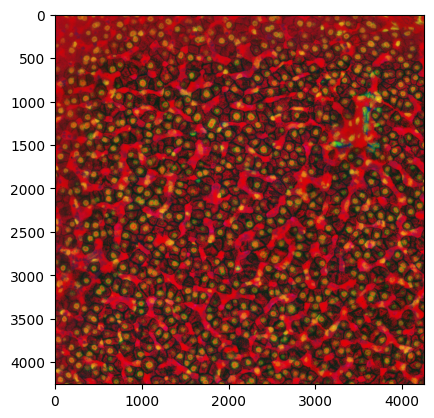

 22%|██▏       | 22/100 [09:45<34:43, 26.71s/it]

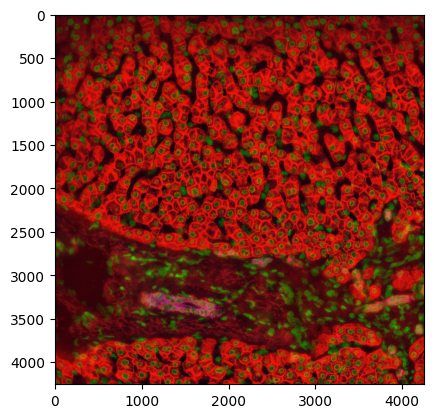

 23%|██▎       | 23/100 [10:13<34:31, 26.90s/it]

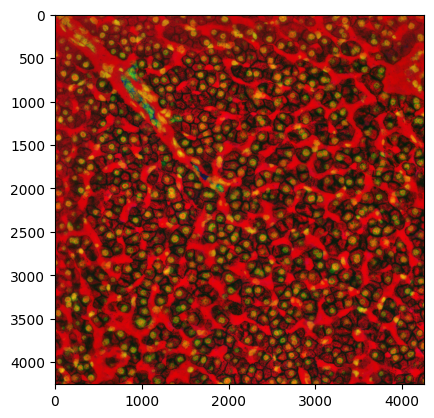

 24%|██▍       | 24/100 [10:40<34:18, 27.08s/it]

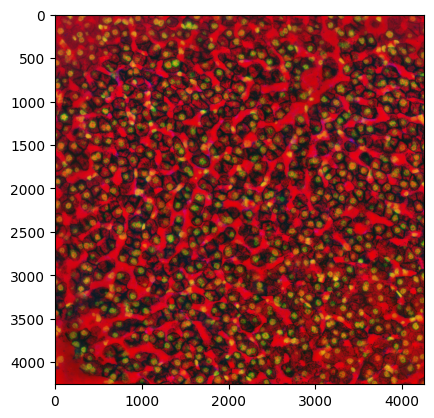

 25%|██▌       | 25/100 [11:07<33:49, 27.06s/it]

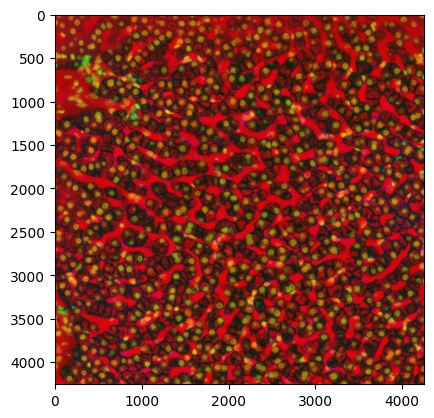

 26%|██▌       | 26/100 [11:34<33:25, 27.10s/it]

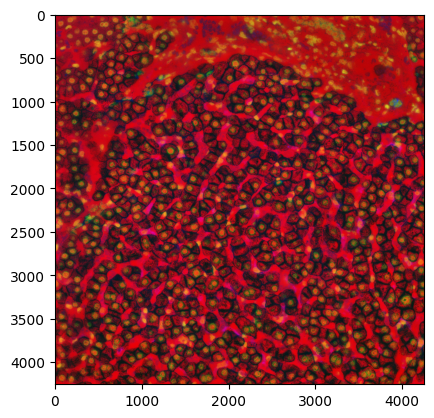

 27%|██▋       | 27/100 [12:02<33:00, 27.14s/it]

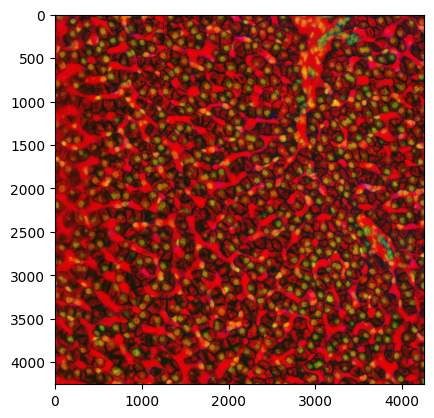

 28%|██▊       | 28/100 [12:29<32:28, 27.07s/it]

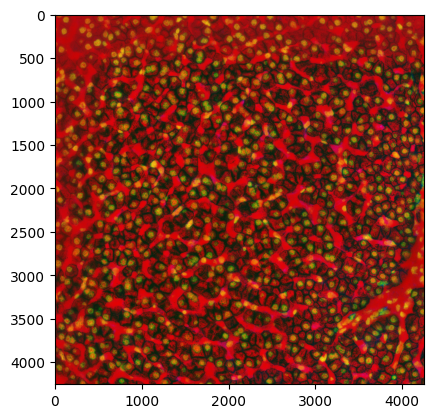

 29%|██▉       | 29/100 [12:53<31:01, 26.21s/it]

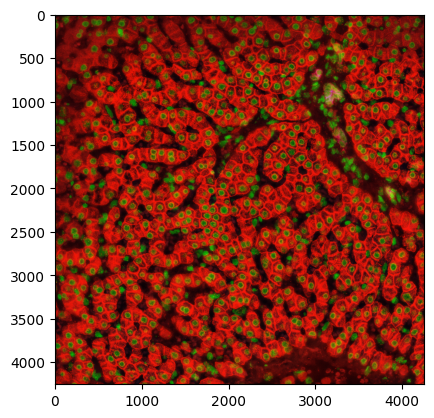

 30%|███       | 30/100 [13:20<30:54, 26.49s/it]

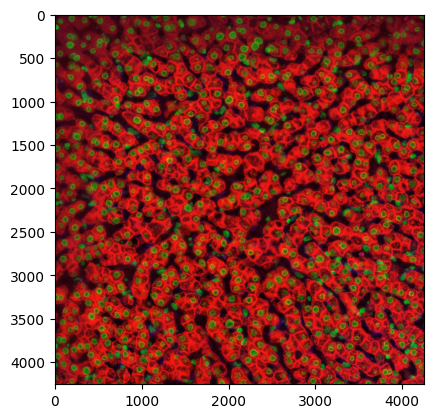

 31%|███       | 31/100 [13:47<30:31, 26.54s/it]

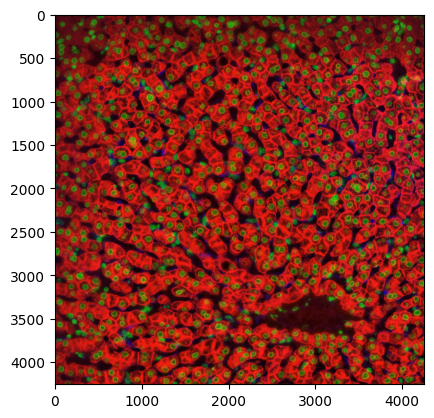

 32%|███▏      | 32/100 [14:14<30:15, 26.70s/it]

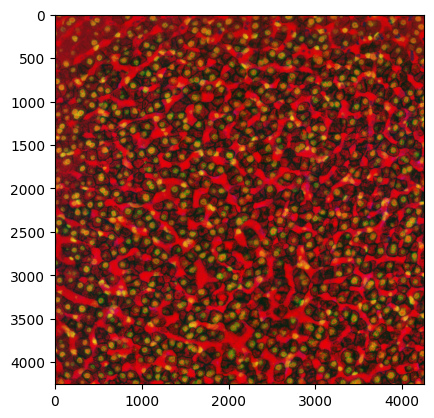

 33%|███▎      | 33/100 [14:40<29:43, 26.63s/it]

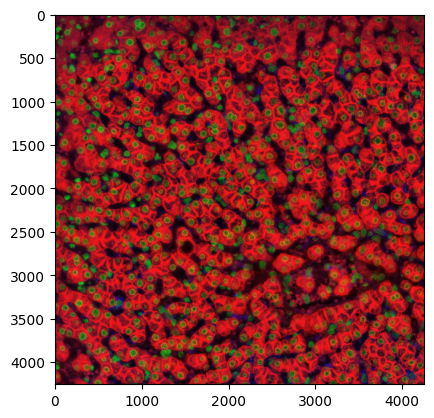

 34%|███▍      | 34/100 [15:07<29:14, 26.59s/it]

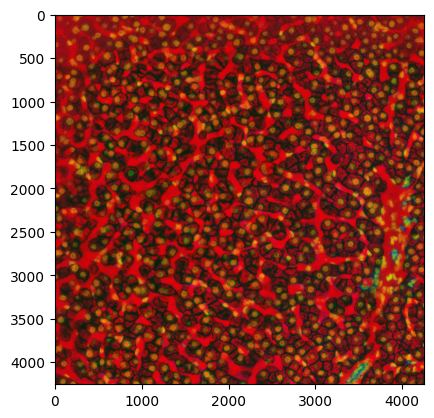

 35%|███▌      | 35/100 [15:33<28:54, 26.68s/it]

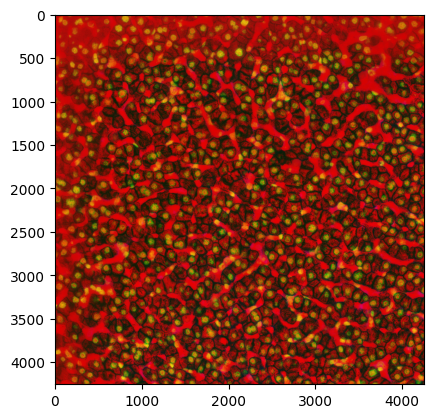

 36%|███▌      | 36/100 [15:59<28:13, 26.46s/it]

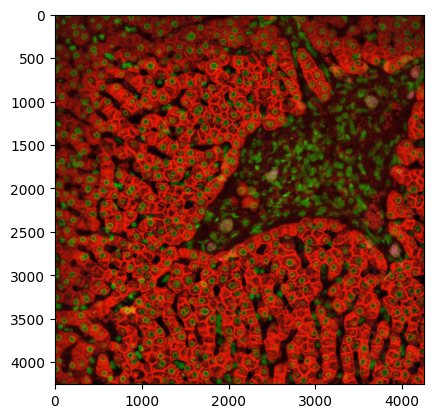

 37%|███▋      | 37/100 [16:25<27:38, 26.33s/it]

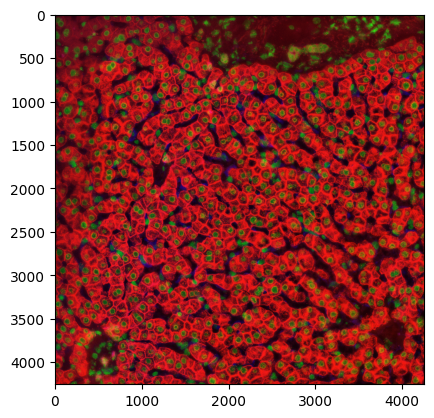

 38%|███▊      | 38/100 [16:52<27:16, 26.39s/it]

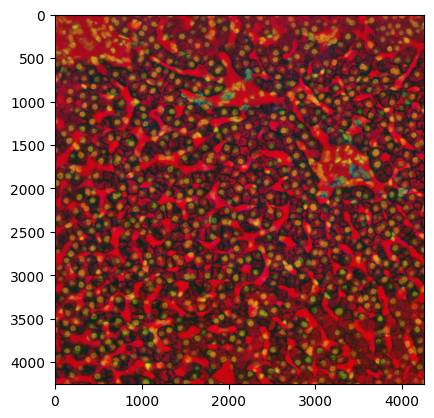

 39%|███▉      | 39/100 [17:19<26:53, 26.45s/it]

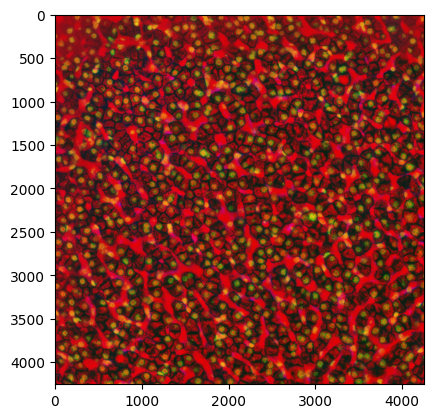

 40%|████      | 40/100 [17:45<26:28, 26.48s/it]

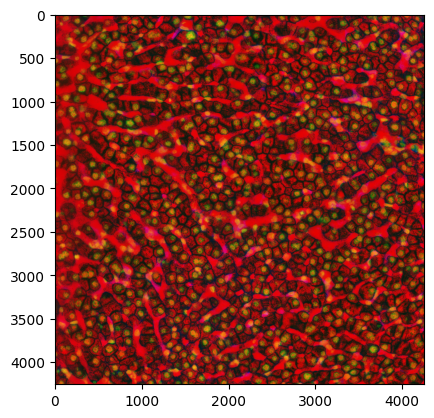

 41%|████      | 41/100 [18:13<26:20, 26.79s/it]

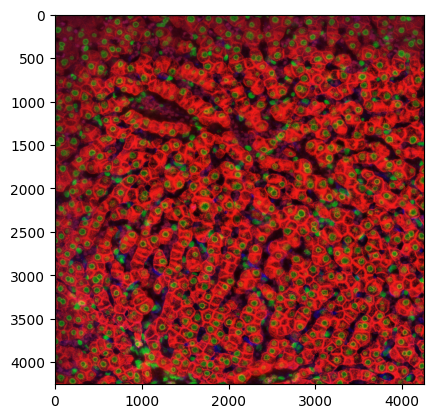

 42%|████▏     | 42/100 [18:41<26:14, 27.15s/it]

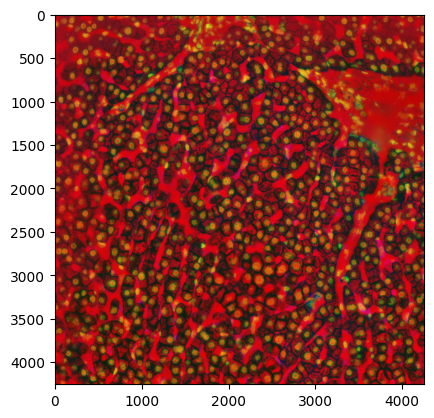

 43%|████▎     | 43/100 [19:08<25:50, 27.21s/it]

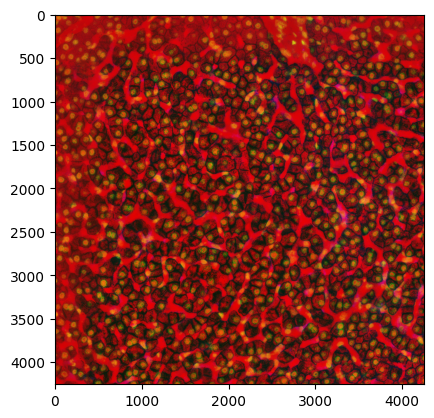

 44%|████▍     | 44/100 [19:35<25:20, 27.15s/it]

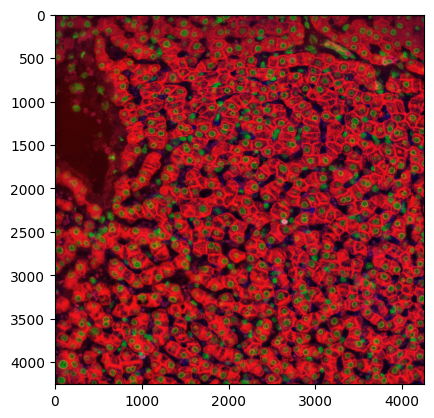

 45%|████▌     | 45/100 [20:01<24:36, 26.84s/it]

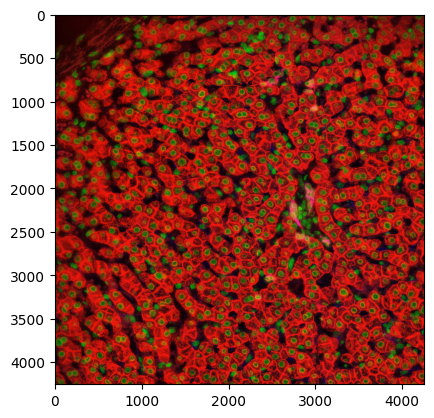

 46%|████▌     | 46/100 [20:28<24:04, 26.74s/it]

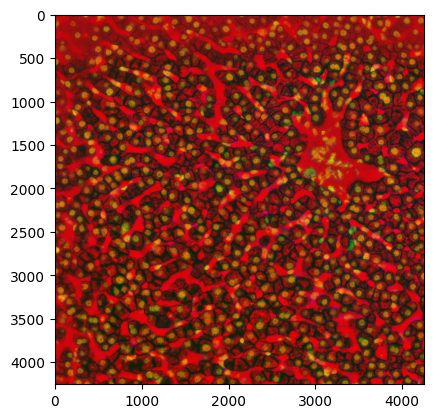

 47%|████▋     | 47/100 [20:55<23:39, 26.79s/it]

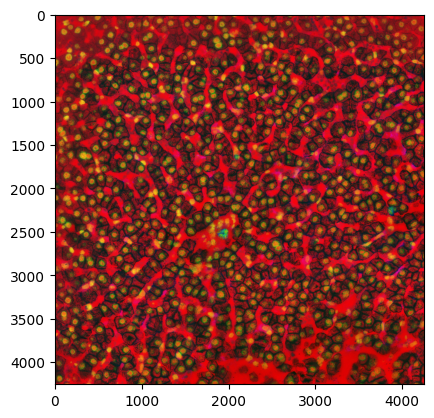

 48%|████▊     | 48/100 [21:22<23:16, 26.86s/it]

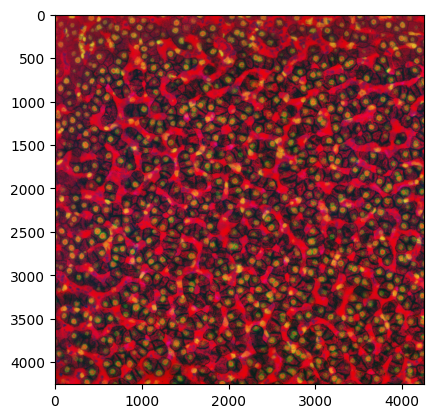

 49%|████▉     | 49/100 [21:48<22:40, 26.67s/it]

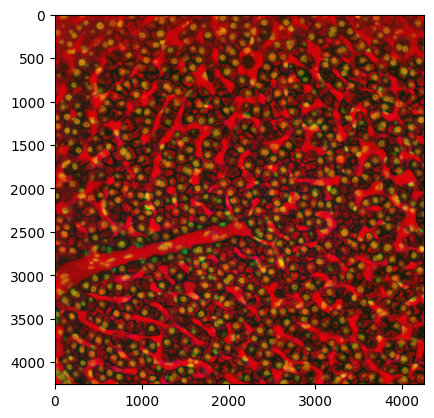

 50%|█████     | 50/100 [22:11<21:23, 25.67s/it]

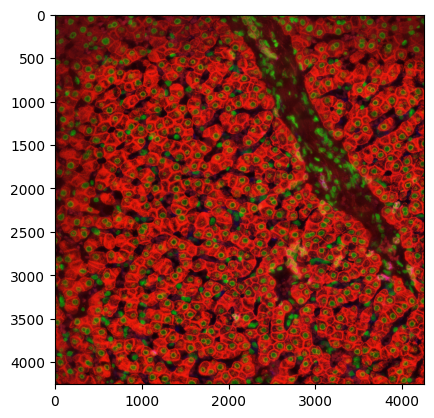

 51%|█████     | 51/100 [22:38<21:12, 25.97s/it]

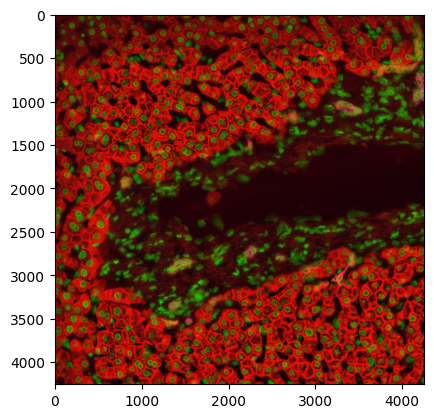

 52%|█████▏    | 52/100 [23:04<20:56, 26.18s/it]

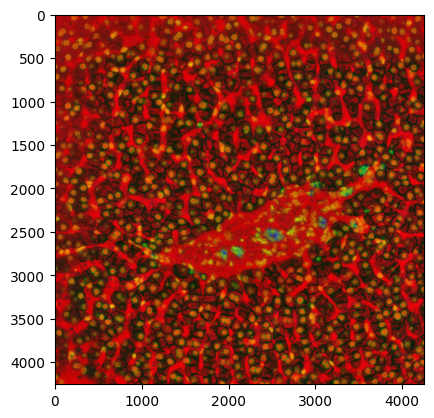

 53%|█████▎    | 53/100 [23:31<20:37, 26.33s/it]

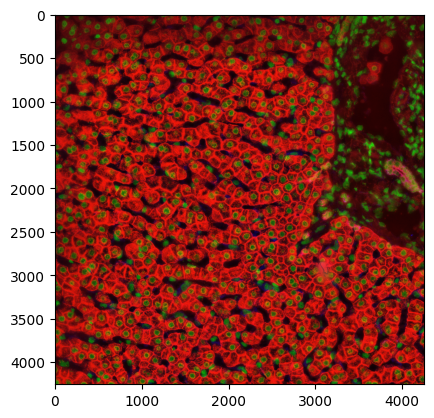

 54%|█████▍    | 54/100 [23:58<20:21, 26.56s/it]

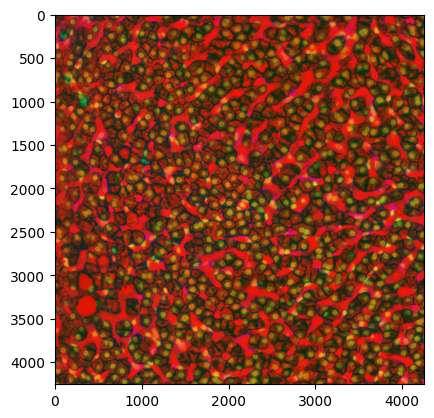

 55%|█████▌    | 55/100 [24:25<19:57, 26.61s/it]

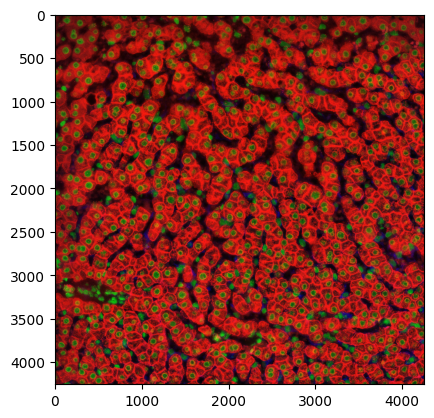

 56%|█████▌    | 56/100 [24:52<19:30, 26.59s/it]

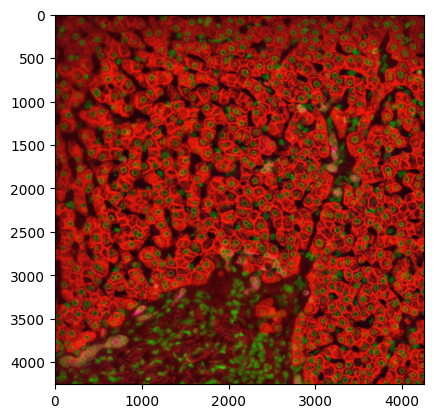

 57%|█████▋    | 57/100 [25:18<18:58, 26.48s/it]

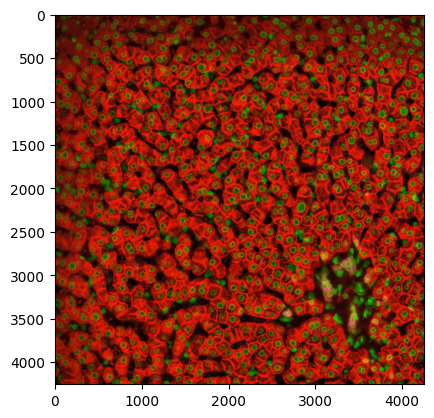

 58%|█████▊    | 58/100 [25:44<18:28, 26.39s/it]

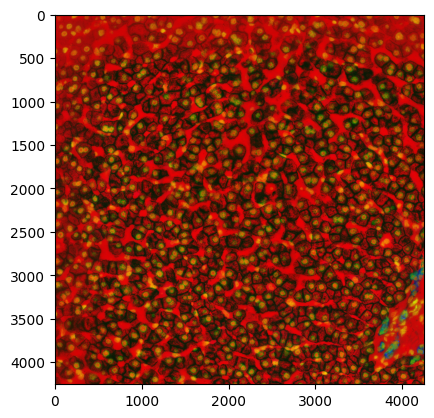

 59%|█████▉    | 59/100 [26:10<18:00, 26.36s/it]

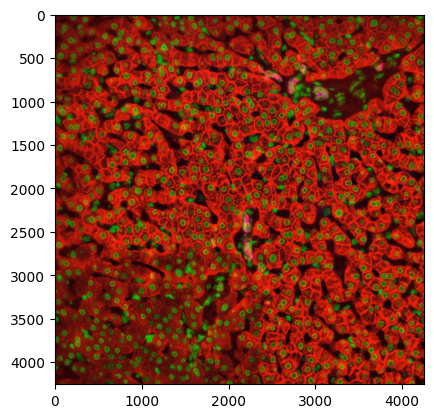

 60%|██████    | 60/100 [26:37<17:39, 26.48s/it]

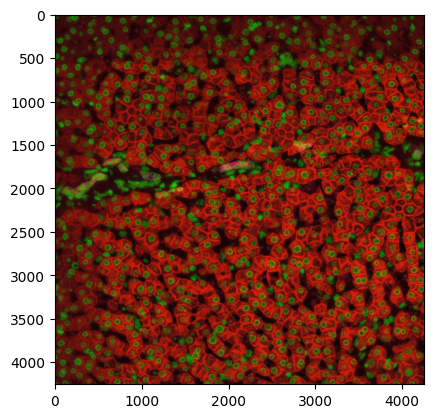

 61%|██████    | 61/100 [27:04<17:16, 26.57s/it]

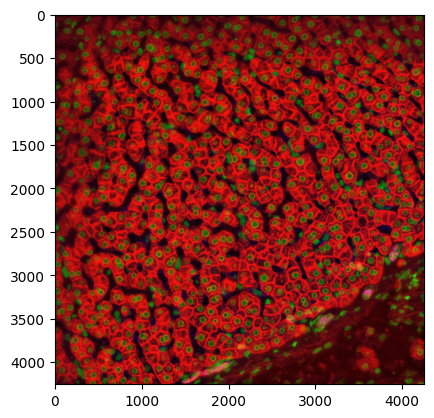

 62%|██████▏   | 62/100 [27:31<16:52, 26.65s/it]

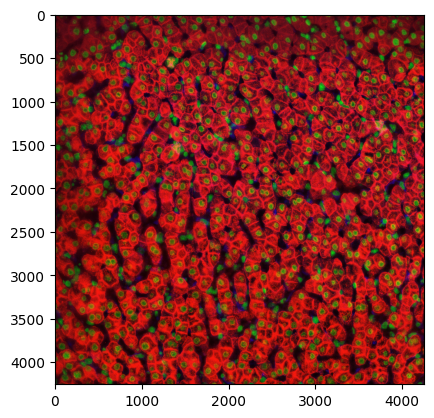

 63%|██████▎   | 63/100 [27:57<16:21, 26.53s/it]

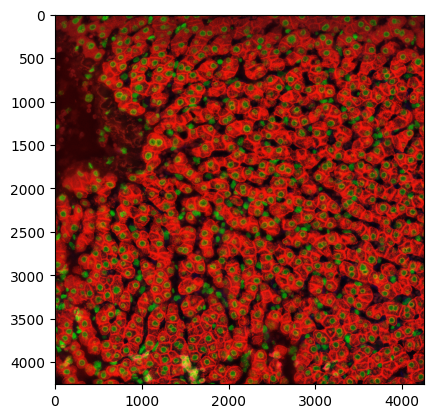

 64%|██████▍   | 64/100 [28:23<15:55, 26.54s/it]

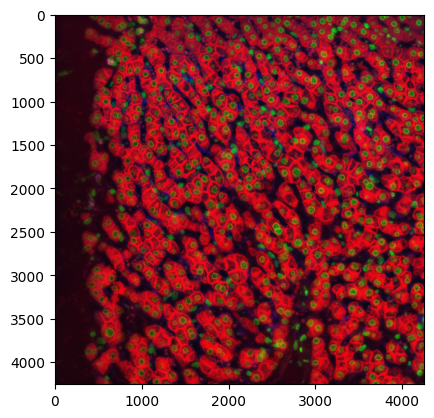

 65%|██████▌   | 65/100 [28:47<14:56, 25.63s/it]

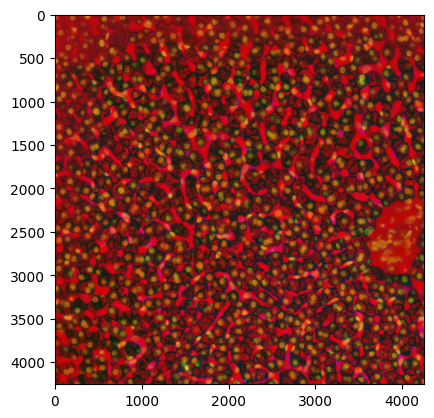

 66%|██████▌   | 66/100 [29:10<14:06, 24.91s/it]

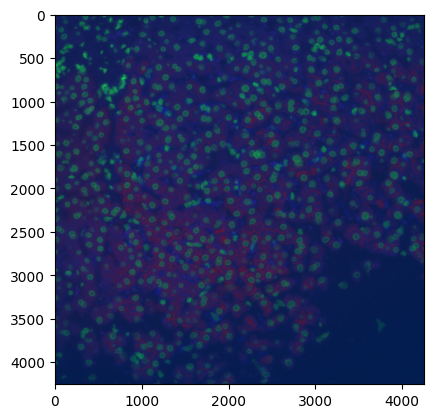

 67%|██████▋   | 67/100 [29:33<13:24, 24.38s/it]

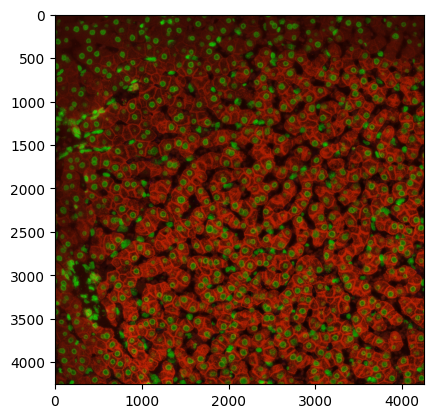

 68%|██████▊   | 68/100 [29:57<12:52, 24.14s/it]

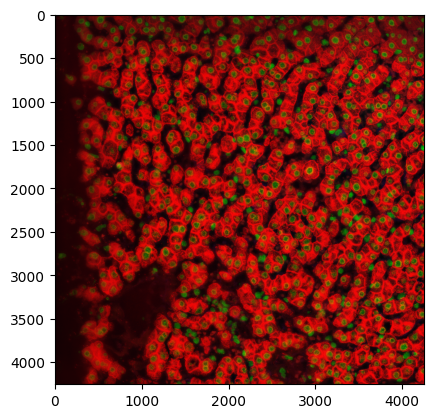

 69%|██████▉   | 69/100 [30:21<12:25, 24.05s/it]

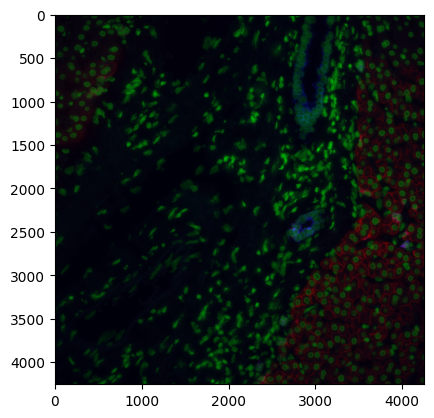

 70%|███████   | 70/100 [30:46<12:08, 24.29s/it]

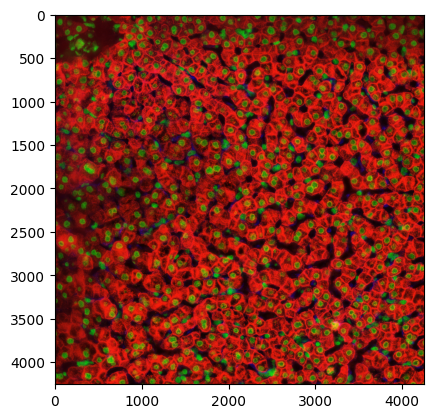

 71%|███████   | 71/100 [31:10<11:48, 24.44s/it]

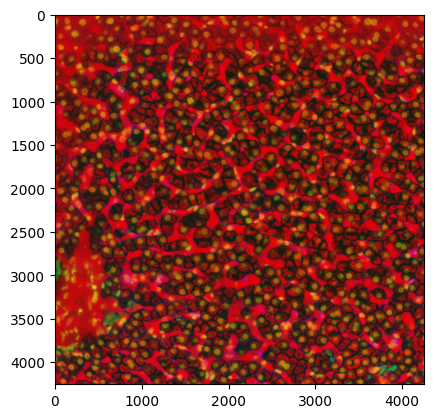

 72%|███████▏  | 72/100 [31:36<11:36, 24.89s/it]

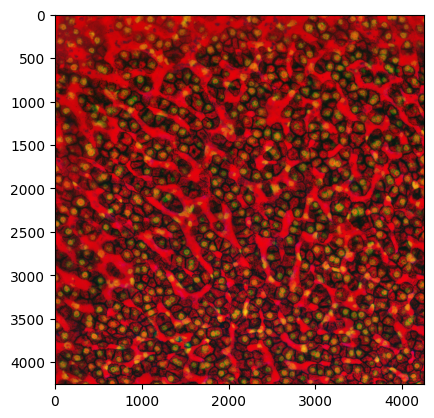

 73%|███████▎  | 73/100 [32:02<11:18, 25.13s/it]

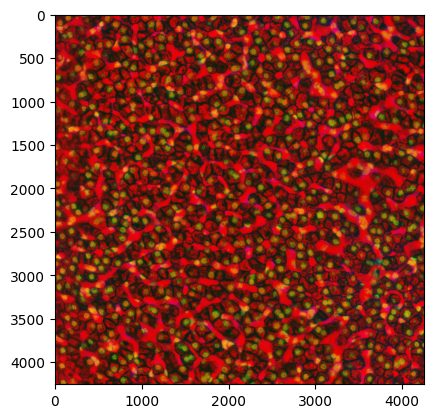

 74%|███████▍  | 74/100 [32:26<10:48, 24.92s/it]

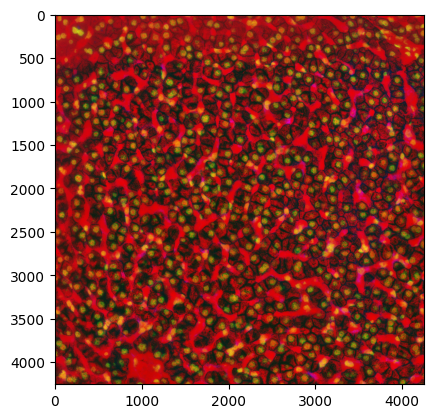

 75%|███████▌  | 75/100 [32:51<10:16, 24.67s/it]

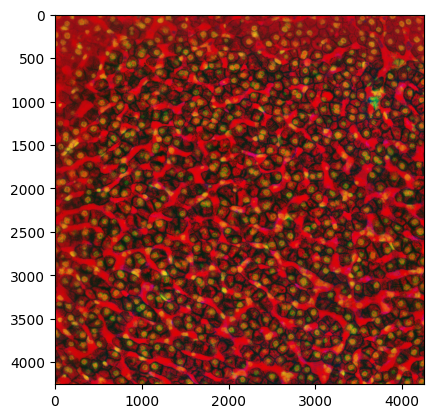

 76%|███████▌  | 76/100 [33:15<09:50, 24.60s/it]

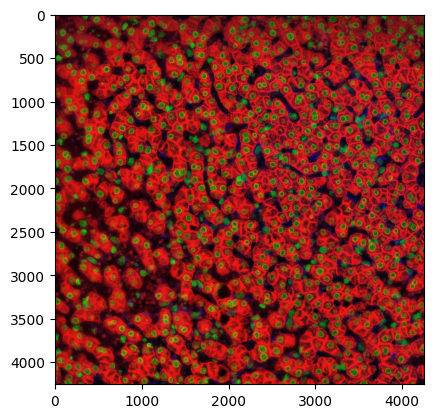

 77%|███████▋  | 77/100 [33:39<09:20, 24.38s/it]

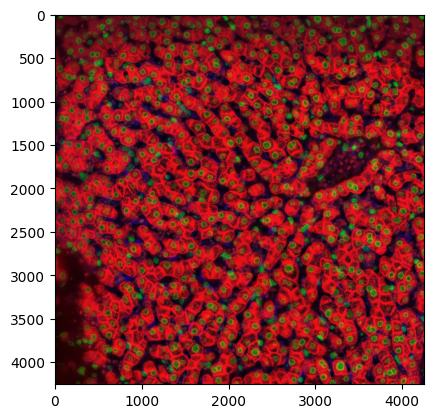

 78%|███████▊  | 78/100 [34:03<08:55, 24.36s/it]

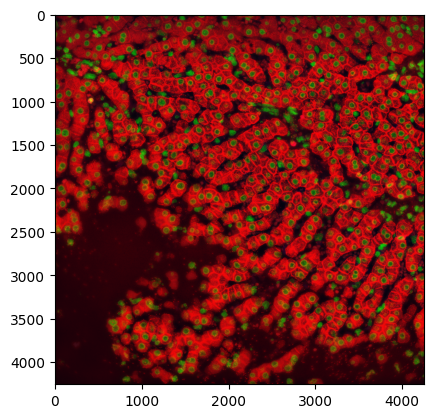

 79%|███████▉  | 79/100 [34:27<08:29, 24.25s/it]

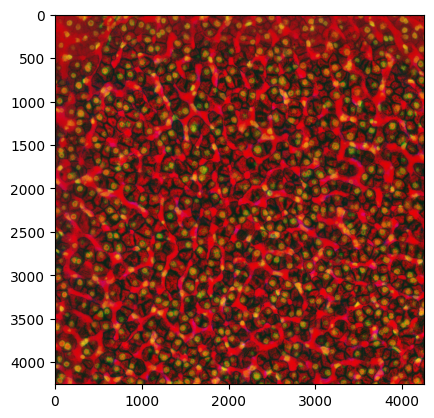

 80%|████████  | 80/100 [34:51<08:04, 24.24s/it]

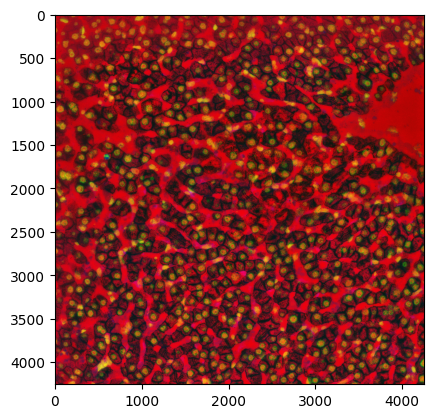

 81%|████████  | 81/100 [35:15<07:40, 24.22s/it]

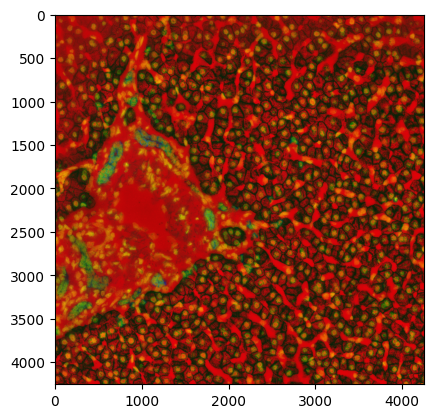

 82%|████████▏ | 82/100 [35:40<07:16, 24.26s/it]

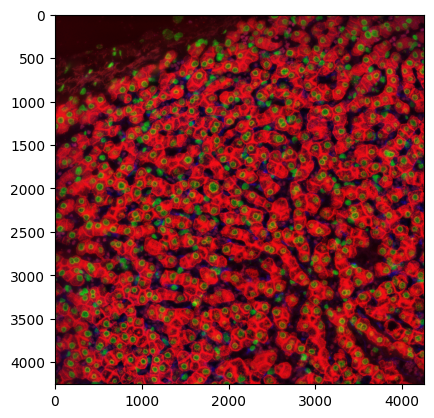

 83%|████████▎ | 83/100 [36:04<06:51, 24.20s/it]

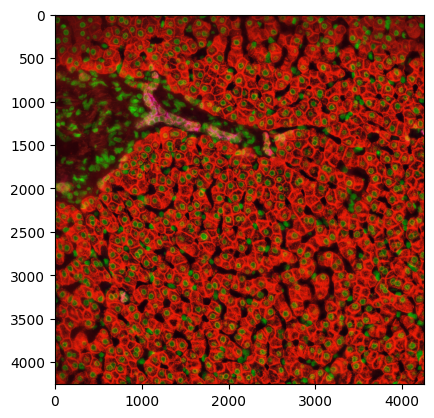

 84%|████████▍ | 84/100 [36:27<06:23, 24.00s/it]

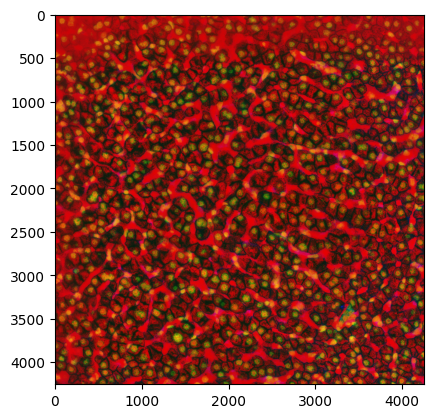

 85%|████████▌ | 85/100 [36:51<05:57, 23.84s/it]

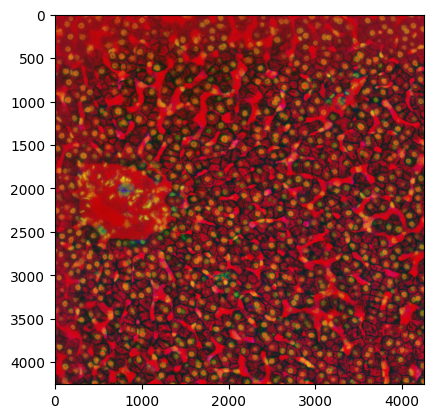

 86%|████████▌ | 86/100 [37:15<05:33, 23.81s/it]

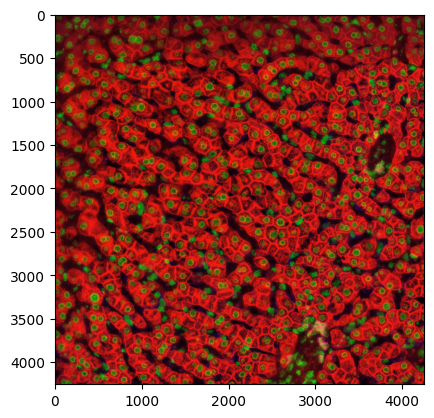

 87%|████████▋ | 87/100 [37:39<05:10, 23.87s/it]

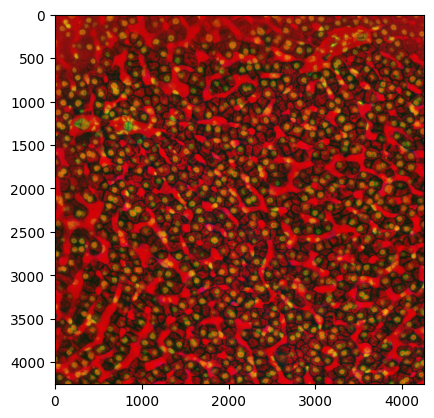

 88%|████████▊ | 88/100 [38:03<04:47, 23.97s/it]

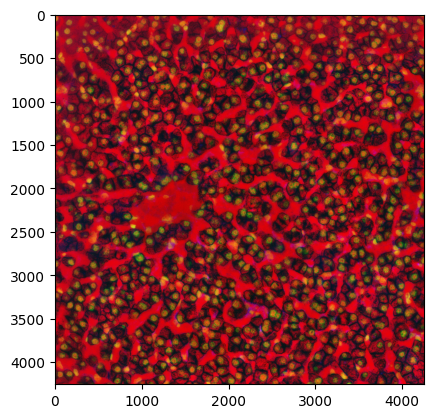

 89%|████████▉ | 89/100 [38:27<04:23, 23.93s/it]

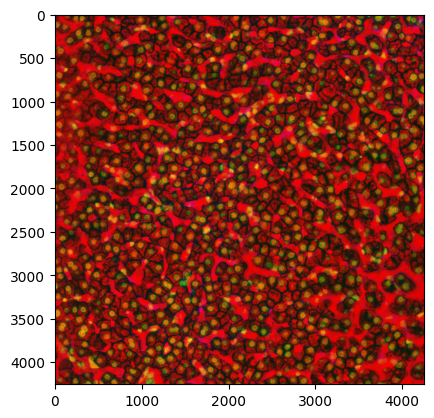

 90%|█████████ | 90/100 [38:50<03:57, 23.76s/it]

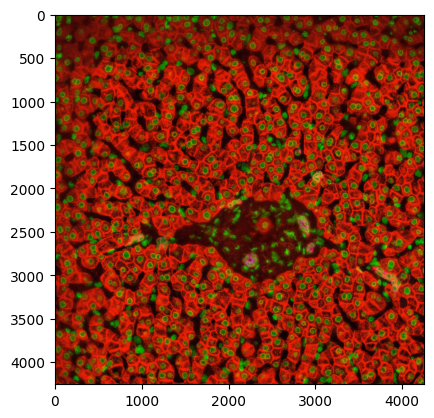

 91%|█████████ | 91/100 [39:14<03:33, 23.77s/it]

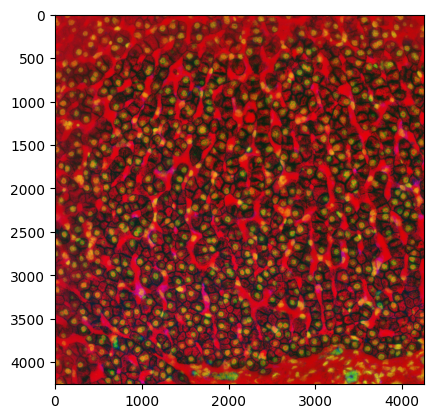

 92%|█████████▏| 92/100 [39:37<03:09, 23.72s/it]

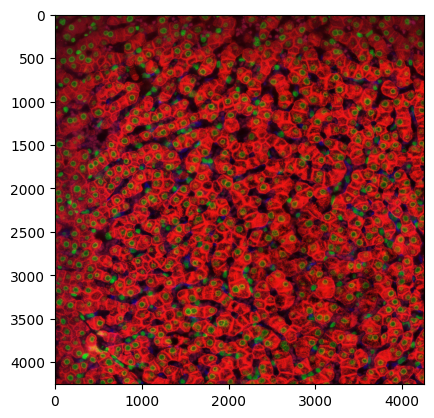

 93%|█████████▎| 93/100 [40:02<02:46, 23.82s/it]

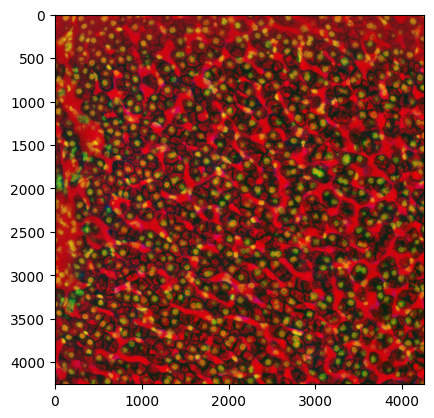

 94%|█████████▍| 94/100 [40:25<02:22, 23.82s/it]

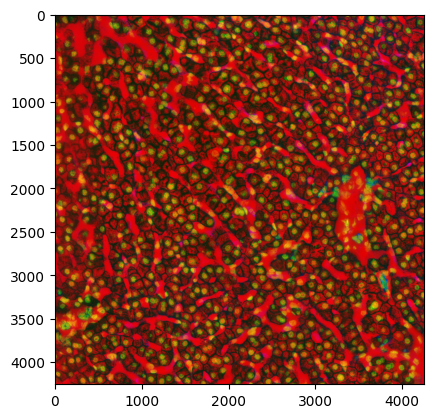

 95%|█████████▌| 95/100 [40:49<01:58, 23.77s/it]

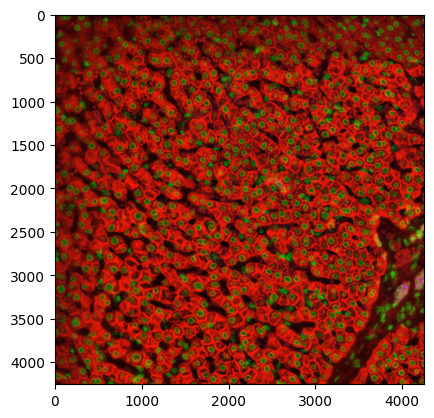

 96%|█████████▌| 96/100 [41:13<01:35, 23.79s/it]

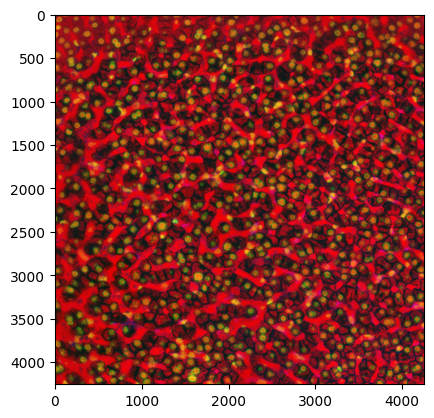

 97%|█████████▋| 97/100 [41:36<01:11, 23.73s/it]

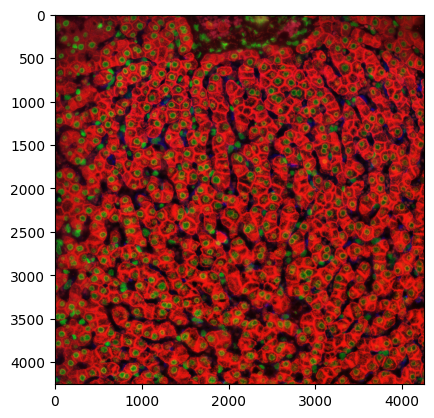

 98%|█████████▊| 98/100 [42:00<00:47, 23.59s/it]

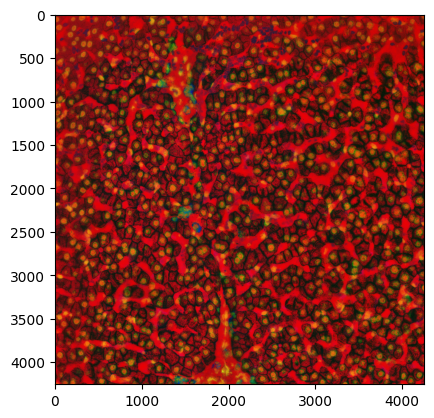

 99%|█████████▉| 99/100 [42:23<00:23, 23.60s/it]

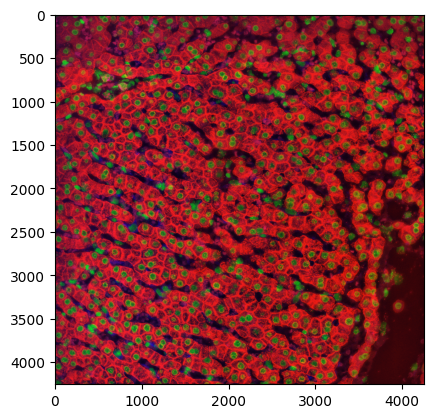

100%|██████████| 100/100 [42:47<00:00, 23.68s/it]

100%|██████████| 100/100 [42:47<00:00, 25.68s/it]

In [4]:
for sample in tqdm(SAMPLES):
    sample_str = str(sample)
    if len(sample_str) == 1:
        sample_str = f"00{sample}"
    elif len(sample_str) == 2:
        sample_str = f"0{sample}"
    
    sample_str = f"F{sample_str}"
    
    img_path = glob.glob(f"../cosMx_human_liver/data/cosMx_human_liver/NormalLiverFiles/CellStatsDir/Morphology2D_Normalized/*{sample_str}*.TIF")
    
    
    assert len(img_path) == 1, img_path
    img_path = img_path[0]
    
    load_image(img_path, sample)
    
    
    
    
    